# Chicago Crimes 2025 Project

## Задача

<div style="border: 1px solid red; padding: 10px;">

_Задача исследования - Используя данные о преступлениях в Чикаго с использованием набора данных Chicago Crime Dataset, определить самые частые виды преступлений, какие преступления чаще приводят к арестам, изучить географическое распределение преступлений._


# План работы

<div style="border: 1px solid gray; padding: 10px; border-radius: 5px;">
    
 **1. Загрузка и первичное исследование данных**

  - Импорт необходимых библиотек
  - Загрузка данных
  - Просмотр общей информации о данных
    
 **2. Предобработка данных**

  - Проверка наличия пропущенных значений
  - Приведение типов данных
  - Проверка и удаление дубликатов
 **3.Исследовательский анализ данных**

  - Подсчет общего количества преступлений
  - Выявление самых распространенных типов преступлений

 **4.Анализ географического распределения преступлений**
  - Выявление районов с наибольшей криминальной активностью
    
 **5. Визуализация типов преступности, успешности арестов и карты преступлений.**
 
 **Выводы и рекомендации**

  - Формирование ключевых выводов на основе анализа

# Описание данных

<div style="border: 1px solid gray; padding: 10px; border-radius: 5px;">

_**Датасет -Crimes_2025.csv-:**_

  - `ID`: Уникальный идентификатор каждого случая преступления.
    
  - `Case` Number: Номер дела.
  - `Date`: Дата и время преступления.
  - `Primary Type`: Основной тип преступления (например, нападение, кража, сексуальное насилие и т.д.).
  - `Location Description`: Описание места происшествия (например, улица, подъезд, больница и т.д.).
  - `Arrest`: Указывает, был ли произведен арест (True или False).
  - `Beat`: Номер участка полиции, где произошло преступление.
  - `District`: Номер полицейского района.
  - `Community Area`: Сообщество, где произошло преступление, в соответствии с определенными районами города.
  - `Year`: Год, когда произошло преступление.
  - `Latitude`: Географическая широта места преступления.
  - `Longitude`: Географическая долгота места преступления.
  - `Location`: Географические координаты в виде точки (широта, долгота).

In [10]:
#Импорт библиотек
import pandas as pd
import matplotlib.pyplot as plt 
import folium

In [11]:
df = pd.read_csv("D:/bodya/Data_Analyst_Pet_Projects/ChicagoCrimes/Crimes_2025.csv")


In [12]:
df = df.drop(['Block', 'IUCR', 'Description', 'Domestic', 'Ward', 'FBI Code', 'X Coordinate', 'Y Coordinate', 'Updated On'], axis=1)

In [4]:
df.head(10) #Вывод 10 первых строк


,ID,Case Number,Date,Primary Type,Location Description,Arrest,Beat,District,Community Area,Year,Latitude,Longitude,Location
0,13761241,JJ160950,02/25/2025 12:00:00 AM,BATTERY,STREET,False,621,6,71,2025,41.751928,-87.644077,POINT (-87.644077264 41.751928332)
1,13758436,JJ161145,02/25/2025 12:00:00 AM,THEFT,RESIDENCE - PORCH / HALLWAY,False,1413,14,22,2025,41.926496,-87.711272,POINT (-87.711272034 41.92649591)
2,13761404,JJ164710,02/25/2025 12:00:00 AM,THEFT,STREET,False,2514,25,19,2025,41.938534,-87.769664,POINT (-87.769664489 41.938534467)
3,13759742,JJ162571,02/25/2025 12:00:00 AM,SEX OFFENSE,APARTMENT,False,621,6,44,2025,41.748107,-87.637877,POINT (-87.637877407 41.748106575)
4,13760822,JJ164097,02/25/2025 12:00:00 AM,THEFT,HOSPITAL BUILDING / GROUNDS,False,2031,20,4,2025,41.975122,-87.698899,POINT (-87.698898525 41.975121537)
5,13759622,JJ162644,02/25/2025 12:00:00 AM,THEFT,APARTMENT,False,732,7,68,2025,41.768236,-87.642041,POINT (-87.642040549 41.76823645)
6,13758406,JJ161010,02/25/2025 12:00:00 AM,CRIMINAL DAMAGE,RESIDENCE - GARAGE,False,921,9,58,2025,41.820691,-87.690802,POINT (-87.690802238 41.820691149)
7,13758384,JJ161012,02/25/2025 12:00:00 AM,NARCOTICS,STREET,True,1121,11,23,2025,41.895480,-87.714298,POINT (-87.714298449 41.895480474)
8,13758413,JJ161046,02/25/2025 12:00:00 AM,CRIMINAL DAMAGE,RESIDENCE,False,424,4,46,2025,41.732897,-87.549937,POINT (-87.549937166 41.732897026)
9,13758247,JJ160863,02/24/2025 11:50:00 PM,WEAPONS VIOLATION,SIDEWALK,False,623,6,69,2025,41.751453,-87.624568,POINT (-87.624567581 41.751452878)


## Описание данных:

- ID: Это может быть уникальный идентификатор для каждой строки данных (преступления).

- Date: Дата и время совершения преступления.
                
- Primary Type: Тип преступления (например, кража, убийство, нападение и т. д.).

- Description: Более детальное описание преступления.

- Location Description: Местоположение, где произошло преступление (например, улица, парк, здание).
                
- Arrest: Информация о том, был ли произведен арест (1 - арест, 0 - без ареста).
                
- Latitude/Longitude: Координаты местоположения преступления.
                
- Year/Month/Day: Год, месяц и день совершения преступления.
                
- District: Полицейский район или округ, где произошло преступление.
                
- Community Area: Район, в котором совершено преступление (может быть в виде кода района).

In [5]:
df.info() # общая информация о датасете

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31340 entries, 0 to 31339
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   ID                    31340 non-null  int64  
 1   Case Number           31340 non-null  object 
 2   Date                  31340 non-null  object 
 3   Primary Type          31340 non-null  object 
 4   Location Description  31271 non-null  object 
 5   Arrest                31340 non-null  bool   
 6   Beat                  31340 non-null  int64  
 7   District              31340 non-null  int64  
 8   Community Area        31340 non-null  int64  
 9   Year                  31340 non-null  int64  
 10  Latitude              31277 non-null  float64
 11  Longitude             31277 non-null  float64
 12  Location              31277 non-null  object 
dtypes: bool(1), float64(2), int64(5), object(5)
memory usage: 2.9+ MB


In [6]:
df.describe() # cтатистика по числовым данным

,ID,Beat,District,Community Area,Year,Latitude,Longitude
count,3.134000e+04,31340.000000,31340.000000,31340.000000,31340.0,31277.000000,31277.000000
mean,1.370936e+07,1152.650798,11.299043,36.575016,2025.0,41.846125,-87.669076
std,5.841702e+05,714.304266,7.141032,21.577809,0.0,0.087292,0.059362
min,2.854500e+04,111.000000,1.000000,1.000000,2025.0,41.644590,-87.922965
25%,1.372169e+07,532.000000,5.000000,23.000000,2025.0,41.771722,-87.711739
50%,1.373441e+07,1031.000000,10.000000,32.000000,2025.0,41.864045,-87.661882
75%,1.374687e+07,1732.000000,17.000000,53.000000,2025.0,41.909294,-87.627139
max,1.376481e+07,2535.000000,31.000000,77.000000,2025.0,42.022536,-87.525406


# Анализ столбцов на основе описательной статистики

### 1. Столбец 'ID'
- Если в столбце 'ID' минимальное значение будет очень маленьким или равным 0, это может указывать на ошибку. Такие значения нужно проверять на корректность.

### 2. Столбец 'Arrest'
- Для столбца 'Arrest' проверим, если есть значения, которые не соответствуют допустимым (например, значения, отличные от "True" или "False"). Если в данных есть другие значения, это может указывать на ошибку.

### 3. Столбец 'Location Description'
- Если в столбце 'Location Description' присутствуют значения "NA" или "Unknown" в огромном количестве, это может быть связано с отсутствием данных. Нужно оценить, является ли это нормой для данного столбца или это ошибка в данных.

### 4. Столбец 'Latitude' и 'Longitude'
- Параметры широты ('Latitude') и долготы ('Longitude') должны находиться в пределах:
  - Широта от -90 до 90.
  - Долгота от -180 до 180.
- Нужно проверить, есть ли значения, выходящие за эти пределы, так как это может указывать на ошибочные данные.

### 5. Столбец 'Date'
- Для столбца 'Date' необходимо проверить корректность формата дат. 
- Невозможно, чтобы дата была в будущем или на несколько лет назад, если это явно ошибка.

### 6. Столбец 'Primary Type'
- Для столбца 'Primary Type' нужно провести аналогичный анализ, как для типа преступлений. Проверим на необычные значения или аномалии, которые могут указывать на ошибочные данные.



In [7]:
(df.isnull().sum()) #проверка на пропущенные значения

ID                       0
Case Number              0
Date                     0
Primary Type             0
Location Description    69
Arrest                   0
Beat                     0
District                 0
Community Area           0
Year                     0
Latitude                63
Longitude               63
Location                63
dtype: int64

## Анализ пропущенных значений:
 #### Столбец 'Location Description' (69 пропущенных значений):
- В этом столбце отсутствуют значения в 69 случаях, что может указывать на отсутствие информации о местоположении. Это нужно исследовать: Возможно, для некоторых случаев информация не была предоставлена или не применялась.
- Можно обработать пропущенные значения путем их удаления или замены (например, на 'Unknown').

 #### Столбец 'Latitude' (63 пропущенных значений):
- Пропущены данные по широте в 63 случаях. Это может означать, что для некоторых случаев не было зафиксировано географическое местоположение.
- Такие строки можно удалить или обработать пропущенные значения.

 #### Столбец 'Longitude' (63 пропущенных значений):
- Аналогично к 'Latitude'.
      
 #### Столбец 'Location' (63 пропущенных значений):
- Пропущенные данные в этом столбце также могут указывать на отсутствие информации о точном местоположении.


In [8]:
df.dtypes

ID                        int64
Case Number              object
Date                     object
Primary Type             object
Location Description     object
Arrest                     bool
Beat                      int64
District                  int64
Community Area            int64
Year                      int64
Latitude                float64
Longitude               float64
Location                 object
dtype: object

## Анализ типов данных каждого столбца
- Столб 'ID' (тип int): Ошибок здесь не будет, но можно проверить на наличие дублирующихся значений, чтобы убедиться, что каждый ID уникален.
- Столб 'Case Number' (тип object): Можно проверить, если в данных есть какие-либо невалидные или пустые значения.
- Столб 'Date' (тип object): Дата представлена как строка, ее нужно будет преобразовать в формат datetime для дальнейшего анализа.
- Столб 'Primary Type' (тип object): Необходимо проверить, не содержит ли этот столбец аномальных значений или дубликатов.
- Столб 'Location Description' (тип object): Можно проверить на наличие пустых значений.
- Столб 'Arrest' (тип bool): Можно проверить, сколько преступлений привели к аресту.
- Столб 'Beat' (тип int): Проверим, чтобы не было отрицательных значений или дубликатов.
- Столб 'District' (тип int): Нужно убедиться, что значения в пределах разумных границ.
- Столб 'Community Area' (тип int): Аналогично предыдущим столбцам, проверим на значения, выходящие за пределы возможных.
- Столб 'Year' (тип int): Тип верный, датасет представляет данные за 2025 год, проверок не требуется.
- Столбцы 'Latitude' и 'Longitude' (тип float): Проверим их на корректность (широта от -90 до 90, долгота от -180 до 180).
- Столб 'Location' (тип object): Аналогично столбцу Location Description, можно проверить на аномалии или пропущенные значения.

In [9]:
print(df['ID'].duplicated().sum()) # проверка на дубликаты

0


In [10]:
print(df['Case Number'].isna().sum()) # проверка на пропущенные значения
print(df['Case Number'].duplicated().sum())
df = df.drop_duplicates(subset='Case Number')

0
4


In [16]:
df['Date'] = pd.to_datetime(df['Date'], errors='coerce') # преобразование в datetime

In [17]:
print(df['Date'].isna().sum()) # проверка на ошибки при преобразовании

0


In [18]:
print(df['Primary Type'].value_counts()) # частота различных типов преступлений

Primary Type
THEFT                                7327
BATTERY                              5378
CRIMINAL DAMAGE                      3034
ASSAULT                              2708
OTHER OFFENSE                        2556
MOTOR VEHICLE THEFT                  2312
DECEPTIVE PRACTICE                   1875
NARCOTICS                            1427
BURGLARY                             1074
ROBBERY                               894
WEAPONS VIOLATION                     799
CRIMINAL TRESPASS                     744
OFFENSE INVOLVING CHILDREN            228
CRIMINAL SEXUAL ASSAULT               194
SEX OFFENSE                           170
INTERFERENCE WITH PUBLIC OFFICER      152
PUBLIC PEACE VIOLATION                145
STALKING                               69
ARSON                                  57
HOMICIDE                               53
CONCEALED CARRY LICENSE VIOLATION      46
LIQUOR LAW VIOLATION                   27
PROSTITUTION                           21
INTIMIDATION         

In [19]:
print(df['Location Description'].isna().sum())
print(df['Location Description'].value_counts())

69
Location Description
STREET                               7984
APARTMENT                            6534
RESIDENCE                            3756
SMALL RETAIL STORE                   1415
SIDEWALK                             1284
                                     ... 
CEMETARY                                1
CREDIT UNION                            1
FOREST PRESERVE                         1
VEHICLE - COMMERCIAL: TROLLEY BUS       1
YARD                                    1
Name: count, Length: 104, dtype: int64


In [20]:
print(df['Arrest'].value_counts())

Arrest
False    25700
True      5636
Name: count, dtype: int64


In [21]:
print(df['Beat'] > 0)

0        True
1        True
2        True
3        True
4        True
         ... 
31335    True
31336    True
31337    True
31338    True
31339    True
Name: Beat, Length: 31336, dtype: bool


In [22]:
print(df['Beat'].duplicated().sum()) 

31062


In [23]:
print(df['District'].min(), df['District'].max()) # проверка границ

1 31


In [24]:
print(df['Community Area'].min(), df['Community Area'].max())

1 77


In [25]:
print(df['Latitude'].min(), df['Latitude'].max()) # проверка правильности широты

41.644589713 42.022535703


In [26]:
print(df['Longitude'].min(), df['Longitude'].max()) # проверка правильности высоты

-87.922964929 -87.525406297


In [27]:
print(df['Location'].isna().sum())

63


## Выводы по столбцам

- Идентификаторы без дубликатов, номера дел содержат 4 дубликата, что скорее всего - ошибка, дубликаты были успешно удалены. Даты были преобразованы в тип datetime. Значения идентификаторов участка верны, датасет содержит 31066 дубликатов. Это значит, что большинство арестов проводилось одним участком. Значения столбцов District и Community Area в разумных границах. Значения Latitude и Longitude также в разумных границах, соответственно широты и высоты.

In [28]:
print(df[['Latitude', 'Longitude','Location']].isna().sum()) # возвращение к пропущенным значениям в локациях

Latitude     63
Longitude    63
Location     63
dtype: int64


In [29]:
print(df[df['Location'].isna()]['Primary Type'].value_counts())

Primary Type
THEFT                         27
DECEPTIVE PRACTICE            11
OTHER OFFENSE                  6
MOTOR VEHICLE THEFT            5
BURGLARY                       4
ASSAULT                        3
CRIMINAL DAMAGE                2
BATTERY                        1
STALKING                       1
OFFENSE INVOLVING CHILDREN     1
PROSTITUTION                   1
SEX OFFENSE                    1
Name: count, dtype: int64


In [30]:
print(df[df['Location Description'].isna()]['Primary Type'].value_counts())

Primary Type
DECEPTIVE PRACTICE    69
Name: count, dtype: int64


In [31]:
df[['Location Description', 'Location']] = df[['Location Description', 'Location']].fillna('Unknown')

In [32]:
print(df['Longitude'].dtype)


float64


In [33]:
df['Latitude'] = df['Latitude'].fillna(df['Latitude'].median())
df['Longitude'] = df['Longitude'].fillna(df['Longitude'].median())

In [34]:
print(df['Location'].isna().sum())

0


## Анализ столбцов локации('Location','Location Description','Latitude','Longitude'):
- Значения локаций имеют пропуски, был проведён анализ типов преступлений без информации о местоположении.
- *Возможные причины пропусков:*
  -    Некоторые преступления были совершены онлайн (например, DECEPTIVE PRACTICE(мошенничество)).
  -    Не все отчёты содержат точное местоположение(например, заявление подано позже).
  -    Возможны ошибки или неполнота данных при сборе.
- Пропуски были заменены на 'Unknown', так как таким образом мы не потеряем данные и сможем использовать их в дальнейшем анализе(если потребуется). Столбцы 'Latitude' и 'Longitude' были заполнены по медиане(так как значение столбцов float64).

#### Вывод:
#####      Пропуски были заполнены без потерь данных и их можно использовать в дальнейшем анализе.

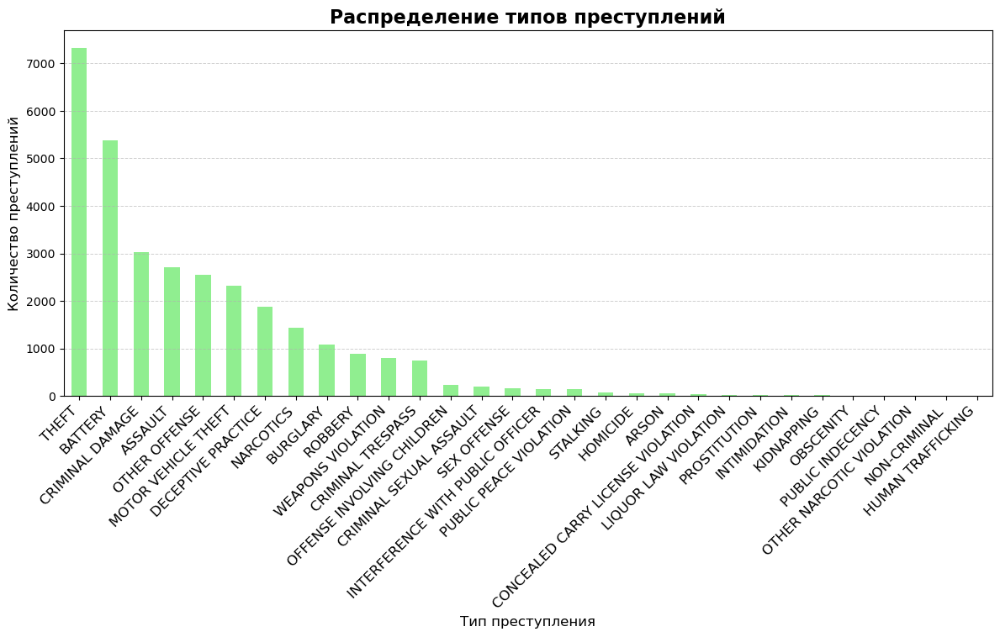

In [8]:
# визуализация типов преступлений
plt.figure(figsize = (12, 8))
df['Primary Type'].value_counts().plot(kind = 'bar', color = 'lightgreen')
plt.title('Распределение типов преступлений', fontsize = 16, weight = 'bold')
plt.xlabel('Тип преступления', fontsize = 12)
plt.ylabel('Количество преступлений', fontsize = 12)
plt.xticks(rotation = 90)
plt.grid(True, which='both', axis='y', linestyle='--', linewidth=0.7, alpha=0.6) # размерная сетка
plt.tight_layout() # предотвращение наложений
plt.xticks(rotation=45, ha='right', fontsize=12) # подписи по оси Х
plt.show()

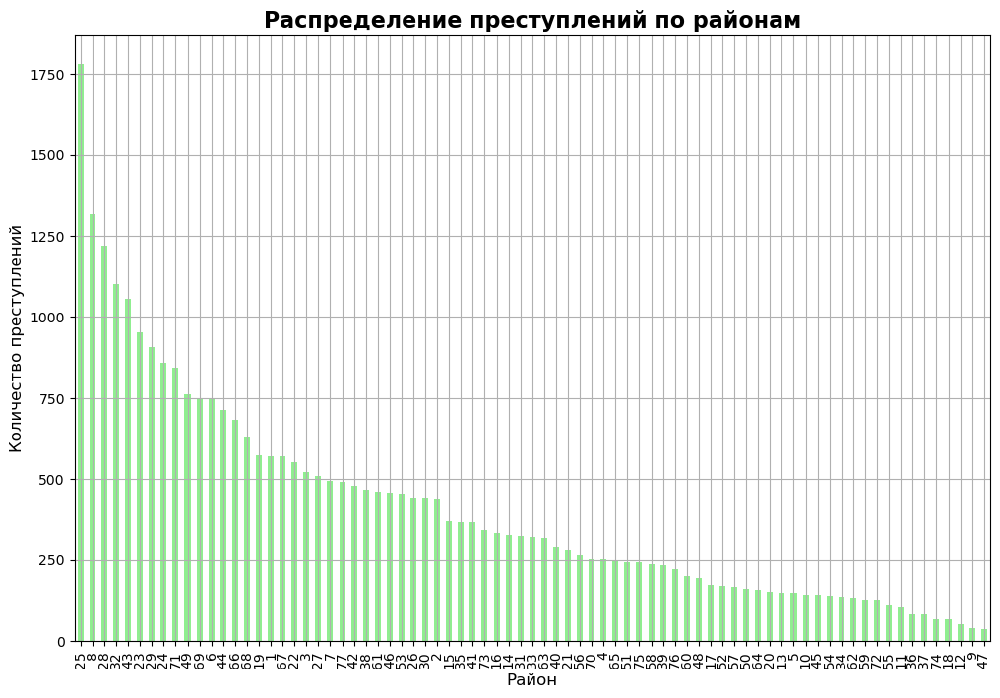

In [6]:
plt.figure(figsize=(12, 8))
df['Community Area'].value_counts().plot(kind='bar', color='lightgreen')
plt.title('Распределение преступлений по районам', fontsize=16, weight='bold')
plt.xlabel('Район', fontsize=12)
plt.ylabel('Количество преступлений', fontsize=12)
plt.grid(True)
plt.show()


In [24]:
theft_count = df[df['Primary Type'] == 'THEFT'].shape[0]
print(theft_count)


7327


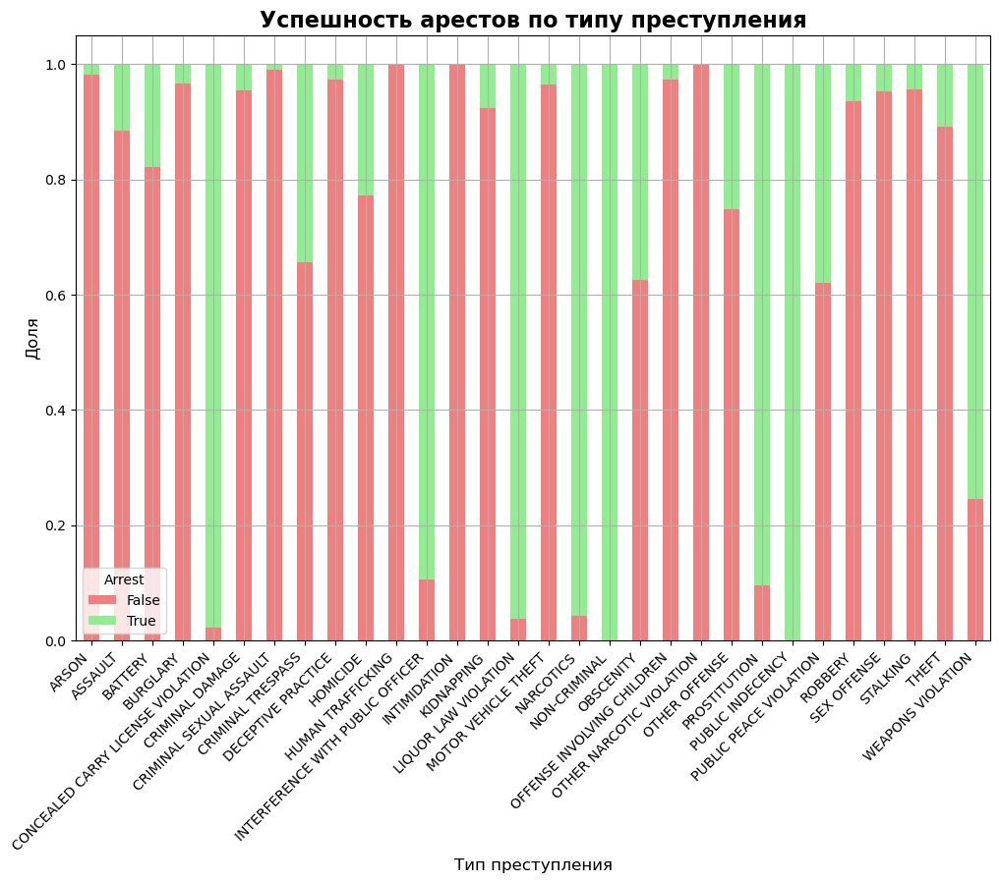

In [7]:
arrest_by_crime = df.groupby('Primary Type')['Arrest'].value_counts(normalize=True).unstack()
arrest_by_crime = arrest_by_crime.fillna(0)  # Заполняем NaN значением 0
arrest_by_crime.plot(kind='bar', stacked=True, figsize=(12, 8), color=['lightcoral', 'lightgreen'])
plt.title('Успешность арестов по типу преступления', fontsize=16, weight='bold')
plt.xlabel('Тип преступления', fontsize=12)
plt.ylabel('Доля', fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.grid(True)
plt.show()

In [18]:
df['Latitude'] = df['Latitude'].fillna(value=0)  # заполняет пропущенные значения широты
df['Longitude'] = df['Longitude'].fillna(value=0)  # заполняет пропущенные значения долготы


In [17]:
# создание базовой карты
m = folium.Map(location=[df['Latitude'].mean(), df['Longitude'].mean()], zoom_start=10)

# добавление точек на карту
for index, row in df.iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=5,
        color='red',
        fill=True,
        fill_color='red'
    ).add_to(m)

# отображение карты
m

<div style="border: 1px solid gray; padding: 10px; border-radius: 5px;">

# Общий вывод

В ходе выполнения проекта был проведен комплексный исследовательский анализ данных о преступлениях с целью выявления закономерностей и факторов, влияющих на их совершение. Исследуемая выборка данных охватывает преступления, совершенные в период с 01.01.2025 по 22.02.2025.

## Результаты анализа

1. **Основные виды преступлений, зарегистрированные в период исследования**:
    - Уголовный ущерб, побои и кражи, с наибольшим числом случаев среди них краж(7327 случаев).
      

    
2. **Наибольшее количество преступлений**:
    - Наибольшее количество преступлений было зарегистрировано в 25 районе, что может указывать на особенную опасность и угрозу преступлений района.
      


4. **Успешность арестов**:
    - *Высокая успешность арестов* – Для таких преступлений, как убийство (HOMICIDE), преступления сексуального характера (CRIMINAL SEXUAL ASSAULT) и нападение на сотрудника полиции (BATTERY - PUBLIC OFFICER), аресты происходят в подавляющем большинстве случаев.
      
    - *Низкий уровень арестов* – Для таких преступлений, как угон автомобиля (MOTOR VEHICLE THEFT), кража (THEFT) и жестокое обращение с детьми (OFFENSE INVOLVING CHILDREN), доля арестов значительно ниже.
  
      
    - *Средний уровень арестов* – Некоторые категории преступлений, например, наркотические преступления (OTHER NARCOTIC VIOLATION) и нарушение общественного порядка (PUBLIC PEACE VIOLATION), имеют более сбалансированное соотношение арестов и неарестов.
  
      
    - *Особые категории* – Преступления, такие как проступки, не относящиеся к уголовным (NON-CRIMINAL), редко приводят к арестам.
  
      
    - *Преступления с высокой вариативностью* – Например, проституция (PROSTITUTION), где уровень арестов сильно варьируется, возможно, в зависимости от обстоятельств и политики правоохранительных органов.

